/var/folders/17/7v9_fz593_xfss9zy0542f940000gn/T/ipykernel_66590/2595859986.py:31: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  customer_data['recency'].fillna(customer_data['recency'].mean(), inplace=True)
/var/folders/17/7v9_fz593_xfss9zy0542f940000gn/T/ipykernel_66590/2595859986.py:32: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on 

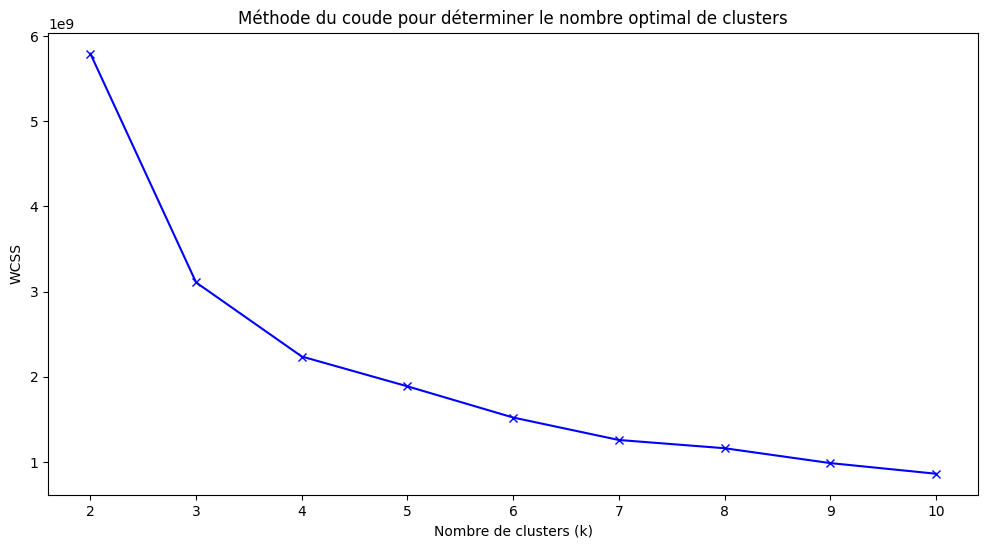

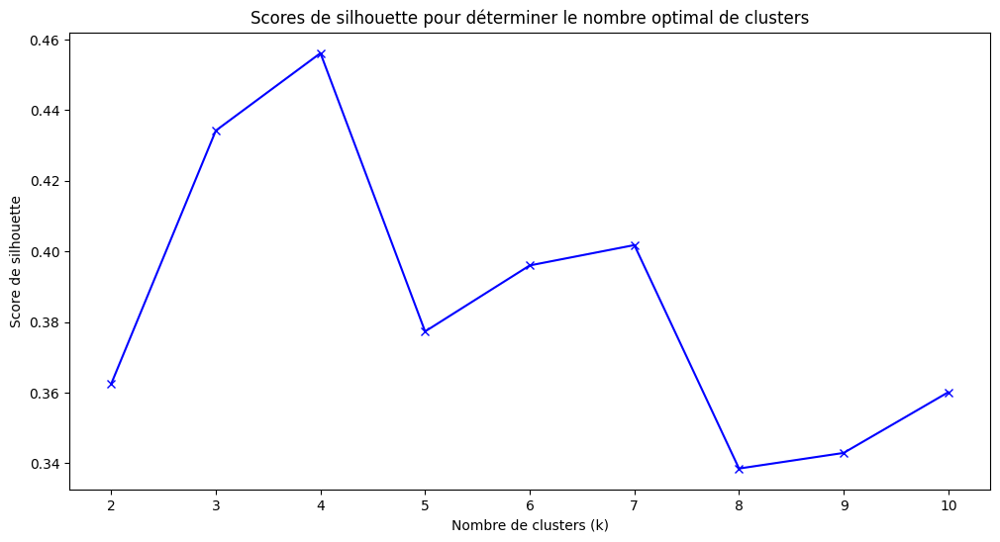

Nombre de clusters: 2, WCSS: 5791742994.43, Score de silhouette: 0.36
Nombre de clusters: 3, WCSS: 3106480417.24, Score de silhouette: 0.43
Nombre de clusters: 4, WCSS: 2237225752.33, Score de silhouette: 0.46
Nombre de clusters: 5, WCSS: 1887219300.84, Score de silhouette: 0.38
Nombre de clusters: 6, WCSS: 1521050554.17, Score de silhouette: 0.40
Nombre de clusters: 7, WCSS: 1257516865.09, Score de silhouette: 0.40
Nombre de clusters: 8, WCSS: 1160740135.15, Score de silhouette: 0.34
Nombre de clusters: 9, WCSS: 986350341.83, Score de silhouette: 0.34
Nombre de clusters: 10, WCSS: 861385902.41, Score de silhouette: 0.36


In [1]:
import pandas as pd
from datetime import datetime
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
import matplotlib.pyplot as plt

# Charger les données
file_path = 'customer_details_v3.csv'  # Remplacez par le chemin correct
customer_data = pd.read_csv(file_path)

# Définir la date actuelle pour l'analyse RFM
current_date = datetime.strptime('2018-10-18', '%Y-%m-%d')

# Calculer la récence (nombre de jours depuis la dernière commande)
customer_data['last_order'] = pd.to_datetime(customer_data['last_order'])
customer_data['recency'] = (current_date - customer_data['last_order']).dt.days

# Calculer la fréquence en utilisant la colonne 'connection_days'
customer_data['frequency'] = customer_data['connection_days']

# Calculer la valeur monétaire en utilisant la colonne 'total_spent'
customer_data['monetary'] = customer_data['total_spent']

# S'assurer que les colonnes sont de type numérique
customer_data['recency'] = pd.to_numeric(customer_data['recency'], errors='coerce')
customer_data['frequency'] = pd.to_numeric(customer_data['frequency'], errors='coerce')
customer_data['monetary'] = pd.to_numeric(customer_data['monetary'], errors='coerce')
customer_data['avg_review_score'] = pd.to_numeric(customer_data['avg_review_score'], errors='coerce')

# Traiter les valeurs manquantes en les remplaçant par la moyenne de la colonne
customer_data['recency'].fillna(customer_data['recency'].mean(), inplace=True)
customer_data['frequency'].fillna(customer_data['frequency'].mean(), inplace=True)
customer_data['monetary'].fillna(customer_data['monetary'].mean(), inplace=True)
customer_data['avg_review_score'].fillna(customer_data['avg_review_score'].mean(), inplace=True)

# Sélectionner les colonnes nécessaires pour le clustering
features = ['recency', 'frequency', 'monetary', 'avg_review_score']

# Préparer les données pour le clustering
clustering_features = customer_data[features]

# Méthode du coude et score de silhouette pour déterminer le nombre optimal de clusters
wcss = []
silhouette_scores = []
K = range(2, 11)
for k in K:
    kmeans = KMeans(n_clusters=k, random_state=42)
    kmeans.fit(clustering_features)
    wcss.append(kmeans.inertia_)
    silhouette_scores.append(silhouette_score(clustering_features, kmeans.labels_))

# Plot de la méthode du coude
plt.figure(figsize=(12, 6))
plt.plot(K, wcss, 'bx-')
plt.xlabel('Nombre de clusters (k)')
plt.ylabel('WCSS')
plt.title('Méthode du coude pour déterminer le nombre optimal de clusters')
plt.show()

# Plot des scores de silhouette
plt.figure(figsize=(12, 6))
plt.plot(K, silhouette_scores, 'bx-')
plt.xlabel('Nombre de clusters (k)')
plt.ylabel('Score de silhouette')
plt.title('Scores de silhouette pour déterminer le nombre optimal de clusters')
plt.show()

# Afficher les valeurs de WCSS et des scores de silhouette
for i, k in enumerate(K):
    print(f"Nombre de clusters: {k}, WCSS: {wcss[i]:.2f}, Score de silhouette: {silhouette_scores[i]:.2f}")

In [2]:
import pandas as pd
from datetime import datetime
from sklearn.cluster import KMeans
from sklearn.metrics import adjusted_rand_score
import numpy as np

# Charger les données
file_path = 'customer_details_v3.csv'  # Remplacez par le chemin correct
customer_data = pd.read_csv(file_path)

# Définir la date actuelle pour l'analyse RFM
current_date = datetime.strptime('2018-10-18', '%Y-%m-%d')

# Calculer la récence (nombre de jours depuis la dernière commande)
customer_data['last_order'] = pd.to_datetime(customer_data['last_order'])
customer_data['recency'] = (current_date - customer_data['last_order']).dt.days

# Calculer la fréquence en utilisant la colonne 'connection_days'
customer_data['frequency'] = customer_data['connection_days']

# Calculer la valeur monétaire en utilisant la colonne 'total_spent'
customer_data['monetary'] = customer_data['total_spent']

# S'assurer que les colonnes sont de type numérique
customer_data['recency'] = pd.to_numeric(customer_data['recency'], errors='coerce')
customer_data['frequency'] = pd.to_numeric(customer_data['frequency'], errors='coerce')
customer_data['monetary'] = pd.to_numeric(customer_data['monetary'], errors='coerce')
customer_data['avg_review_score'] = pd.to_numeric(customer_data['avg_review_score'], errors='coerce')

# Traiter les valeurs manquantes en les remplaçant par la moyenne de la colonne
customer_data['recency'].fillna(customer_data['recency'].mean(), inplace=True)
customer_data['frequency'].fillna(customer_data['frequency'].mean(), inplace=True)
customer_data['monetary'].fillna(customer_data['monetary'].mean(), inplace=True)
customer_data['avg_review_score'].fillna(customer_data['avg_review_score'].mean(), inplace=True)

# Sélectionner les colonnes nécessaires pour le clustering
features = ['recency', 'frequency', 'monetary', 'avg_review_score']

# Préparer les données pour le clustering
clustering_features = customer_data[features]

# Fonction pour effectuer le test de stabilité avec ARI
def stability_test(k, n_init, features):
    aris = []
    for _ in range(n_init):
        kmeans1 = KMeans(n_clusters=k, n_init=1, random_state=np.random.randint(10000)).fit(features)
        kmeans2 = KMeans(n_clusters=k, n_init=1, random_state=np.random.randint(10000)).fit(features)
        ari = adjusted_rand_score(kmeans1.labels_, kmeans2.labels_)
        aris.append(ari)
    return aris

# Effectuer le test de stabilité pour k = 3
k3_aris = stability_test(3, 100, clustering_features)
print(f'Scores ARI pour k=3 avec 100 initialisations : {k3_aris}')
print(f'Score ARI moyen pour k=3 : {np.mean(k3_aris):.2f}')

# Effectuer le test de stabilité pour k = 4
k4_aris = stability_test(4, 100, clustering_features)
print(f'Scores ARI pour k=4 avec 100 initialisations : {k4_aris}')
print(f'Score ARI moyen pour k=4 : {np.mean(k4_aris):.2f}')

/var/folders/17/7v9_fz593_xfss9zy0542f940000gn/T/ipykernel_66590/467498209.py:31: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  customer_data['recency'].fillna(customer_data['recency'].mean(), inplace=True)
/var/folders/17/7v9_fz593_xfss9zy0542f940000gn/T/ipykernel_66590/467498209.py:32: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on wh

Scores ARI pour k=3 avec 100 initialisations : [0.9905037664452073, 0.9997581474364363, 0.9950550196858479, 0.0996985625257645, 0.99665415614774, 0.9880661032055802, 0.9952581072790454, 0.9997581474364363, 0.9587428353621661, 0.09892467792462477, 0.9956438718616385, 0.9976397435698374, 0.9846454711392081, 0.09991209464650969, 0.9893374174302794, 0.9985563917871564, 0.9994231847460451, 0.9958361464775061, 0.9854154708814092, 0.9885832721376007, 0.9937162652178998, 0.09579962029745538, 1.0, 0.9958241127965425, 0.9980823183315045, 0.9955920936409374, 0.9922369710296585, 0.9996004865303467, 0.9999166026668158, 0.9963031539031852, 0.9865987267804746, 0.098797459759628, 0.9983656727403706, 0.9996089678393252, 0.9969828889412087, 0.9947502049919653, 1.0, 0.9925085061540493, 0.9980980310435403, 0.9995163283408032, 0.9958085253616433, 0.9888145246113605, 0.9996747557589236, 0.9917007436866672, 0.9885337375531327, 0.9987173917395142, 0.999208731437479, 0.9939385881818683, 0.9999166026668158, 0.9

/var/folders/17/7v9_fz593_xfss9zy0542f940000gn/T/ipykernel_66590/2832672191.py:31: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  customer_data['recency'].fillna(customer_data['recency'].mean(), inplace=True)
/var/folders/17/7v9_fz593_xfss9zy0542f940000gn/T/ipykernel_66590/2832672191.py:32: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on 

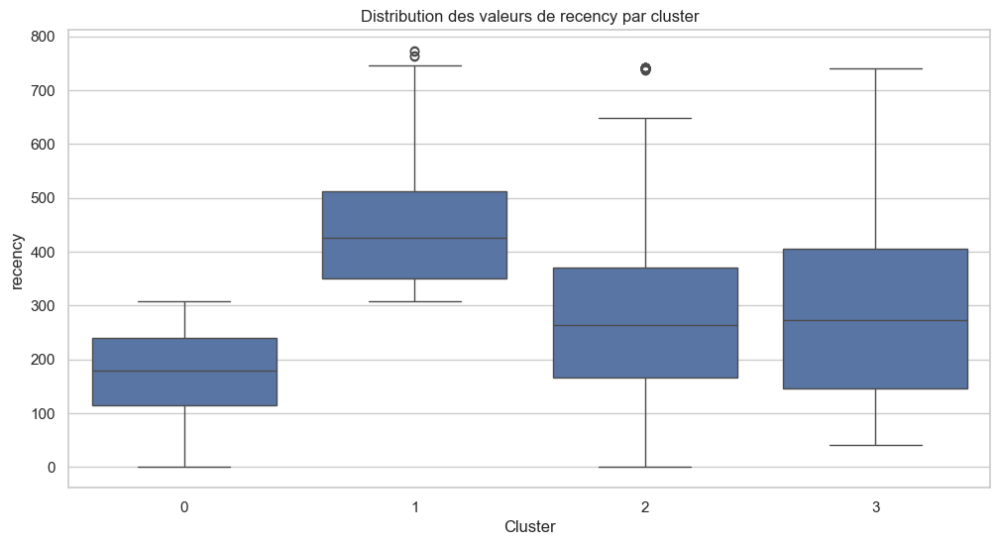

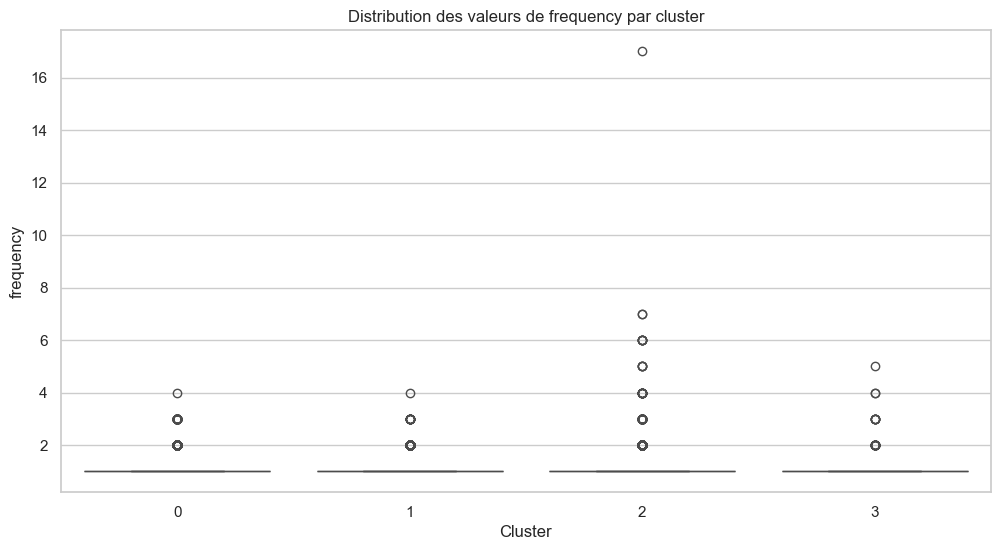

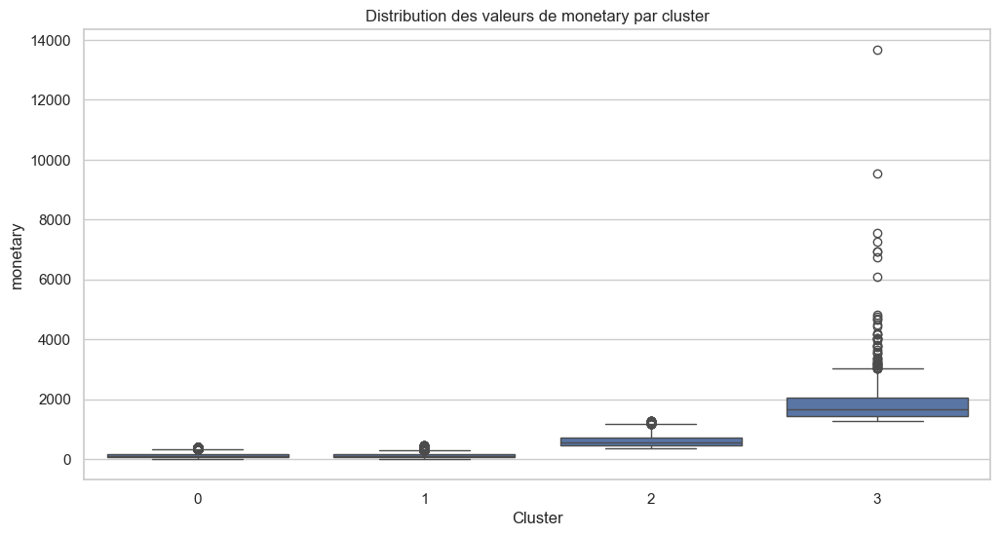

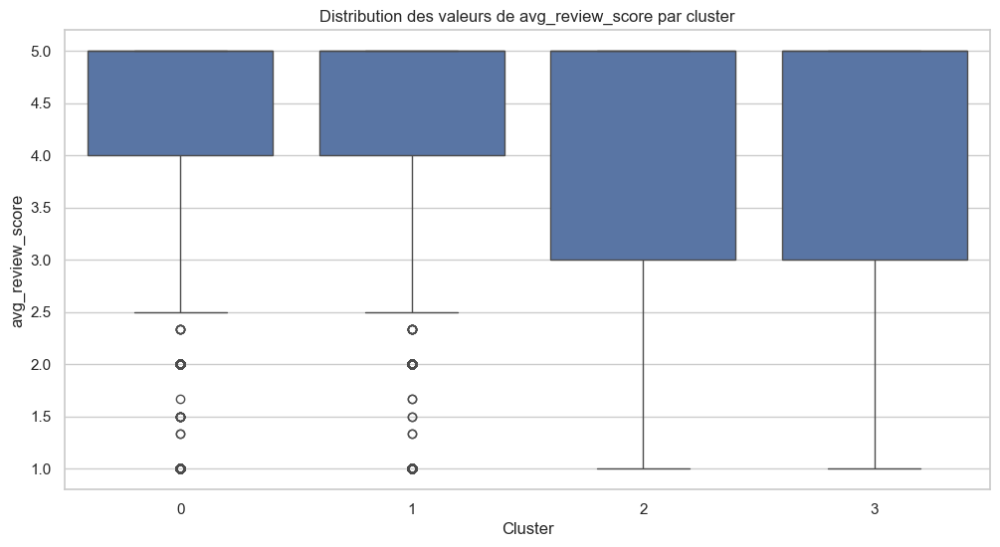

,index,count,mean,std,min,25%,50%,75%,max,Cluster
0,recency,51168.0,177.224027,72.739421,0.00,114.000,179.000,239.0000,307.00,0
1,frequency,51168.0,1.023315,0.159223,1.00,1.000,1.000,1.0000,4.00,0
2,monetary,51168.0,121.262756,78.414471,0.00,60.260,101.745,163.7550,404.82,0
3,avg_review_score,51168.0,4.109210,1.324200,1.00,4.000,5.000,5.0000,5.00,0
4,recency,38112.0,438.301690,96.557447,308.00,351.000,426.000,512.0000,773.00,1
5,frequency,38112.0,1.013408,0.118830,1.00,1.000,1.000,1.0000,4.00,1
6,monetary,38112.0,121.407202,81.188204,10.07,60.750,99.330,160.3525,467.20,1
7,avg_review_score,38112.0,4.087801,1.322615,1.00,4.000,5.000,5.0000,5.00,1
8,recency,6097.0,279.825816,144.421715,1.00,166.000,263.000,371.0000,743.00,2
9,frequency,6097.0,1.103330,0.447892,1.00,1.000,1.000,1.0000,17.00,2


In [3]:
import pandas as pd
from datetime import datetime
from sklearn.cluster import KMeans
import plotly.express as px
import seaborn as sns
import matplotlib.pyplot as plt

# Charger les données
file_path = 'customer_details_v3.csv'  # Remplacez par le chemin correct
customer_data = pd.read_csv(file_path)

# Définir la date actuelle pour l'analyse RFM
current_date = datetime.strptime('2018-10-18', '%Y-%m-%d')

# Calculer la récence (nombre de jours depuis la dernière commande)
customer_data['last_order'] = pd.to_datetime(customer_data['last_order'])
customer_data['recency'] = (current_date - customer_data['last_order']).dt.days

# Calculer la fréquence en utilisant la colonne 'connection_days'
customer_data['frequency'] = customer_data['connection_days']

# Calculer la valeur monétaire en utilisant la colonne 'total_spent'
customer_data['monetary'] = customer_data['total_spent']

# S'assurer que les colonnes sont de type numérique
customer_data['recency'] = pd.to_numeric(customer_data['recency'], errors='coerce')
customer_data['frequency'] = pd.to_numeric(customer_data['frequency'], errors='coerce')
customer_data['monetary'] = pd.to_numeric(customer_data['monetary'], errors='coerce')

# Traiter les valeurs manquantes en les remplaçant par la moyenne de la colonne
customer_data['recency'].fillna(customer_data['recency'].mean(), inplace=True)
customer_data['frequency'].fillna(customer_data['frequency'].mean(), inplace=True)
customer_data['monetary'].fillna(customer_data['monetary'].mean(), inplace=True)

# Sélectionner les colonnes RFM et ajouter progressivement les nouvelles features
features_sets = [
    # ['recency', 'frequency', 'monetary'],  # Initial RFM features
    ['recency', 'frequency', 'monetary', 'avg_review_score'],  # Adding review score
    # More features can be added here in subsequent steps
]

# 'avg_freight_value', 'avg_price', 'avg_payment', 
# 'avg_product_weight_g', 'avg_product_length_cm', 'avg_product_height_cm', 'avg_product_width_cm'

# Traiter les valeurs manquantes dans les autres colonnes en les remplaçant par la moyenne de la colonne
customer_data['avg_review_score'] = pd.to_numeric(customer_data['avg_review_score'], errors='coerce')
customer_data['avg_review_score'].fillna(customer_data['avg_review_score'].mean(), inplace=True)

results = []

for features in features_sets:
    # Préparer les données pour le clustering
    clustering_features = customer_data[features]

    # Choisir le nombre optimal de clusters (k = 3)
    k_optimal = 4
    kmeans_optimal = KMeans(n_clusters=k_optimal, random_state=42)
    kmeans_optimal.fit(clustering_features)
    customer_data['Cluster'] = kmeans_optimal.labels_

    # Fonction pour générer des statistiques descriptives par cluster
    def cluster_statistics(data, cluster_column, feature_columns):
        clusters = data[cluster_column].unique()
        stats = []

        for cluster in clusters:
            cluster_data = data[data[cluster_column] == cluster]
            cluster_stats = cluster_data[feature_columns].describe().T
            cluster_stats['Cluster'] = cluster
            stats.append(cluster_stats)

        return pd.concat(stats)

    # Générer les statistiques descriptives pour chaque cluster
    cluster_stats = cluster_statistics(customer_data, 'Cluster', features)
    cluster_stats.reset_index(inplace=True)
    results.append((features, cluster_stats))

    # Visualisation des clusters en 3D avec les nouvelles caractéristiques (si possible)
    if len(features) >= 3:
        fig_3d = px.scatter_3d(customer_data, x=features[0], y=features[1], z=features[2], color='Cluster',
                               title=f'Plot 3D avec features: {features}')
        fig_3d.show()

    # Distribution des valeurs par cluster pour les features utilisées
    sns.set(style="whitegrid")
    for feature in features:
        plt.figure(figsize=(12, 6))
        sns.boxplot(x='Cluster', y=feature, data=customer_data)
        plt.title(f'Distribution des valeurs de {feature} par cluster')
        plt.xlabel('Cluster')
        plt.ylabel(feature)
        plt.show()

# Afficher les statistiques du dernier set de features
results[-1][1]

In [4]:
customer_data.head()

,customer_unique_id,customer_zip_code_prefix,customer_city,customer_state,geolocation_lat,geolocation_lng,first_order,last_order,total_orders,connection_days,...,avg_price,avg_payment,avg_product_weight_g,avg_product_length_cm,avg_product_height_cm,avg_product_width_cm,recency,frequency,monetary,Cluster
0,0000366f3b9a7992bf8c76cfdf3221e2,7787,cajamar,SP,-23.353453,-46.823060,2018-05-10 10:56:27,2018-05-10 10:56:27,1,1,...,129.90,141.90,1500.0,34.0,7.0,32.0,160,1,141.90,0
1,0000b849f77a49e4a4ce2b2a4ca5be3f,6053,osasco,SP,-23.568119,-46.792981,2018-05-07 11:11:27,2018-05-07 11:11:27,1,1,...,18.90,27.19,375.0,26.0,11.0,18.0,163,1,27.19,0
2,0000f46a3911fa3c0805444483337064,88115,sao jose,SC,-27.561522,-48.637354,2017-03-10 21:05:03,2017-03-10 21:05:03,1,1,...,69.00,86.22,1500.0,25.0,50.0,35.0,586,1,86.22,1
3,0000f6ccb0745a6a4b88665a16c9f078,66812,belem,PA,-1.449059,-48.495507,2017-10-12 20:29:41,2017-10-12 20:29:41,1,1,...,25.99,43.62,150.0,19.0,5.0,11.0,370,1,43.62,1
4,0004aac84e0df4da2b147fca70cf8255,18040,sorocaba,SP,-23.514883,-47.469016,2017-11-14 19:45:42,2017-11-14 19:45:42,1,1,...,180.00,196.89,6050.0,16.0,3.0,11.0,337,1,196.89,1


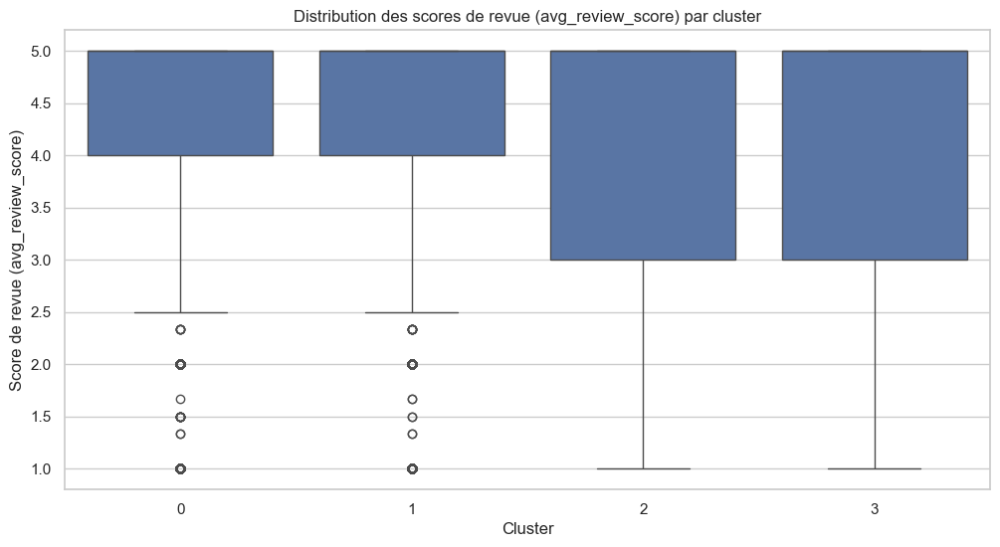

In [5]:
import seaborn as sns
import matplotlib.pyplot as plt

# Plot de la distribution des scores de revue par cluster
plt.figure(figsize=(12, 6))
sns.boxplot(x='Cluster', y='avg_review_score', data=customer_data)
plt.title('Distribution des scores de revue (avg_review_score) par cluster')
plt.xlabel('Cluster')
plt.ylabel('Score de revue (avg_review_score)')
plt.show()

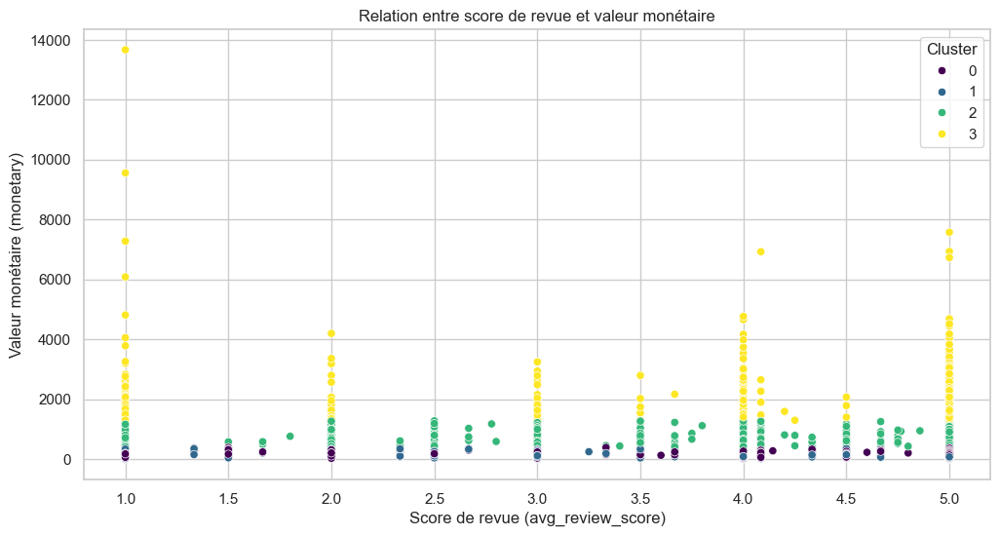

In [6]:
# Scatter plot de la valeur monétaire vs score de revue, coloré par cluster
plt.figure(figsize=(12, 6))
sns.scatterplot(x='avg_review_score', y='monetary', hue='Cluster', data=customer_data, palette='viridis')
plt.title('Relation entre score de revue et valeur monétaire')
plt.xlabel('Score de revue (avg_review_score)')
plt.ylabel('Valeur monétaire (monetary)')
plt.grid(True)
plt.show()

In [7]:
import pandas as pd
from datetime import datetime
from sklearn.cluster import KMeans
import plotly.express as px

# Load the data
file_path = 'customer_details_v3.csv'  # Update with your actual file path
customer_data = pd.read_csv(file_path)

# Define the current date for RFM analysis
current_date = datetime.strptime('2018-10-17', '%Y-%m-%d')

# Calculate recency (number of days since the last order)
customer_data['last_order'] = pd.to_datetime(customer_data['last_order'])
customer_data['recency'] = (current_date - customer_data['last_order']).dt.days

# Calculate frequency using the 'connection_days' column
customer_data['frequency'] = customer_data['connection_days']

# Calculate monetary value using the 'total_spent' column
customer_data['monetary'] = customer_data['total_spent']

# Ensure the columns are numeric
customer_data['recency'] = pd.to_numeric(customer_data['recency'], errors='coerce')
customer_data['frequency'] = pd.to_numeric(customer_data['frequency'], errors='coerce')
customer_data['monetary'] = pd.to_numeric(customer_data['monetary'], errors='coerce')
customer_data['avg_review_score'] = pd.to_numeric(customer_data['avg_review_score'], errors='coerce')

# Handle missing values by replacing them with the mean of the column
customer_data['recency'].fillna(customer_data['recency'].mean(), inplace=True)
customer_data['frequency'].fillna(customer_data['frequency'].mean(), inplace=True)
customer_data['monetary'].fillna(customer_data['monetary'].mean(), inplace=True)
customer_data['avg_review_score'].fillna(customer_data['avg_review_score'].mean(), inplace=True)

# Select the necessary columns for clustering
features = ['recency', 'frequency', 'monetary', 'avg_review_score']
clustering_features = customer_data[features]

# Perform KMeans clustering with k=4
k_optimal = 4
kmeans_optimal = KMeans(n_clusters=k_optimal, random_state=42)
kmeans_optimal.fit(clustering_features)
customer_data['Cluster'] = kmeans_optimal.labels_

# Create the 3D plot with R, M, and avg_review_score
fig_3d = px.scatter_3d(
    customer_data, 
    x='recency', 
    y='monetary', 
    z='avg_review_score', 
    color='Cluster', 
    title='3D Plot des Clusters avec k=4',
    labels={'recency': 'Récence (R)', 'monetary': 'Monétaire (M)', 'avg_review_score': 'Score moyen des avis'}
)

# Show the plot
fig_3d.show()

/var/folders/17/7v9_fz593_xfss9zy0542f940000gn/T/ipykernel_66590/2852085854.py:30: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.



/var/folders/17/7v9_fz593_xfss9zy0542f940000gn/T/ipykernel_66590/2852085854.py:31: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing

/var/folders/17/7v9_fz593_xfss9zy0542f940000gn/T/ipykernel_22440/2832672191.py:31: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  customer_data['recency'].fillna(customer_data['recency'].mean(), inplace=True)
/var/folders/17/7v9_fz593_xfss9zy0542f940000gn/T/ipykernel_22440/2832672191.py:32: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on 

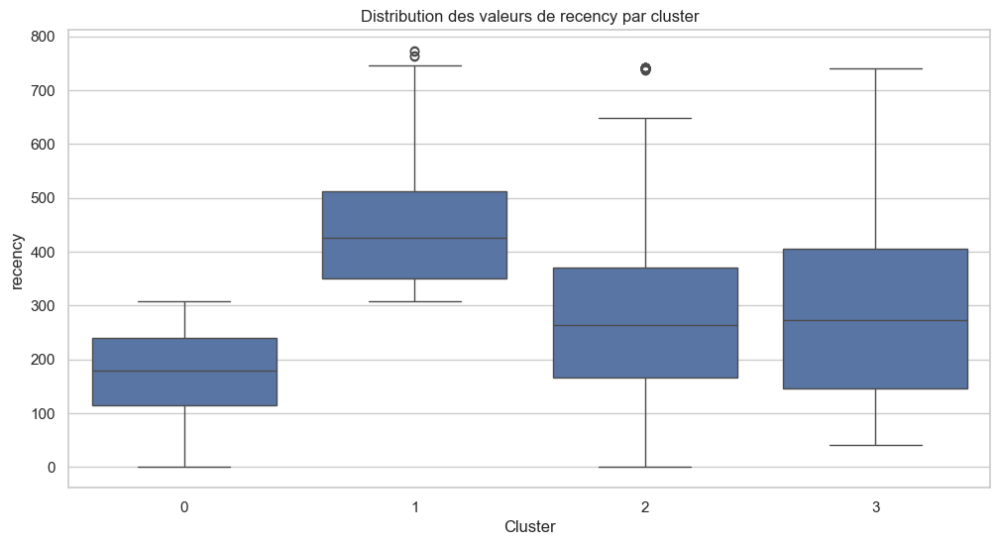

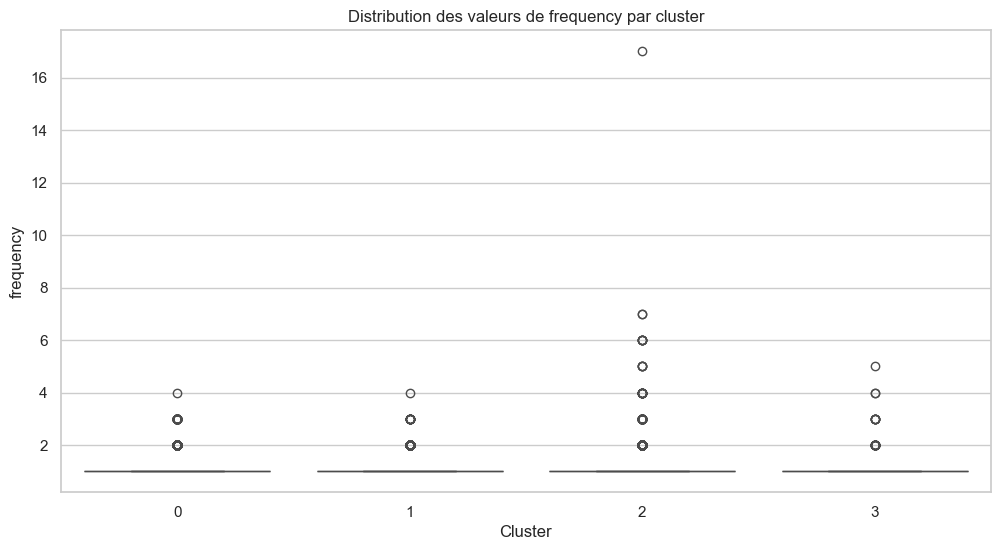

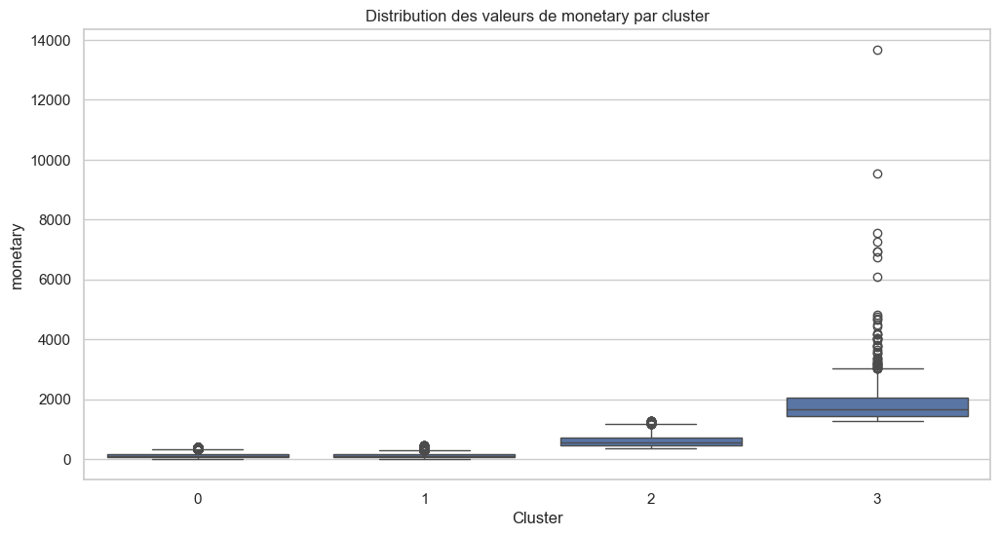

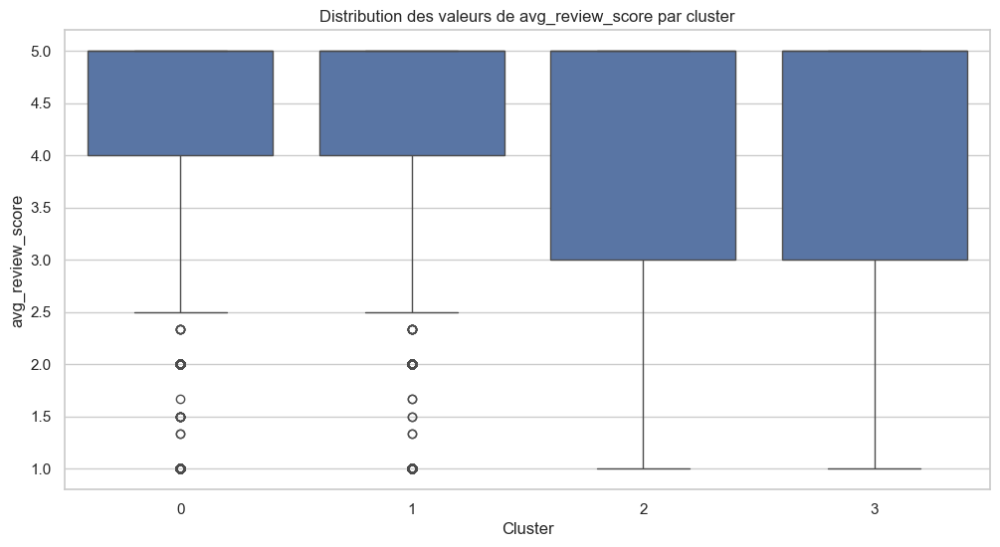

,index,count,mean,std,min,25%,50%,75%,max,Cluster
0,recency,51168.0,177.224027,72.739421,0.00,114.000,179.000,239.0000,307.00,0
1,frequency,51168.0,1.023315,0.159223,1.00,1.000,1.000,1.0000,4.00,0
2,monetary,51168.0,121.262756,78.414471,0.00,60.260,101.745,163.7550,404.82,0
3,avg_review_score,51168.0,4.109210,1.324200,1.00,4.000,5.000,5.0000,5.00,0
4,recency,38112.0,438.301690,96.557447,308.00,351.000,426.000,512.0000,773.00,1
5,frequency,38112.0,1.013408,0.118830,1.00,1.000,1.000,1.0000,4.00,1
6,monetary,38112.0,121.407202,81.188204,10.07,60.750,99.330,160.3525,467.20,1
7,avg_review_score,38112.0,4.087801,1.322615,1.00,4.000,5.000,5.0000,5.00,1
8,recency,6097.0,279.825816,144.421715,1.00,166.000,263.000,371.0000,743.00,2
9,frequency,6097.0,1.103330,0.447892,1.00,1.000,1.000,1.0000,17.00,2


In [2]:
import pandas as pd
from datetime import datetime
from sklearn.cluster import KMeans
import plotly.express as px
import seaborn as sns
import matplotlib.pyplot as plt

# Charger les données
file_path = 'customer_details_v3.csv'  # Remplacez par le chemin correct
customer_data = pd.read_csv(file_path)

# Définir la date actuelle pour l'analyse RFM
current_date = datetime.strptime('2018-10-18', '%Y-%m-%d')

# Calculer la récence (nombre de jours depuis la dernière commande)
customer_data['last_order'] = pd.to_datetime(customer_data['last_order'])
customer_data['recency'] = (current_date - customer_data['last_order']).dt.days

# Calculer la fréquence en utilisant la colonne 'connection_days'
customer_data['frequency'] = customer_data['connection_days']

# Calculer la valeur monétaire en utilisant la colonne 'total_spent'
customer_data['monetary'] = customer_data['total_spent']

# S'assurer que les colonnes sont de type numérique
customer_data['recency'] = pd.to_numeric(customer_data['recency'], errors='coerce')
customer_data['frequency'] = pd.to_numeric(customer_data['frequency'], errors='coerce')
customer_data['monetary'] = pd.to_numeric(customer_data['monetary'], errors='coerce')

# Traiter les valeurs manquantes en les remplaçant par la moyenne de la colonne
customer_data['recency'].fillna(customer_data['recency'].mean(), inplace=True)
customer_data['frequency'].fillna(customer_data['frequency'].mean(), inplace=True)
customer_data['monetary'].fillna(customer_data['monetary'].mean(), inplace=True)

# Sélectionner les colonnes RFM et ajouter progressivement les nouvelles features
features_sets = [
    # ['recency', 'frequency', 'monetary'],  # Initial RFM features
    ['recency', 'frequency', 'monetary', 'avg_review_score'],  # Adding review score
    # More features can be added here in subsequent steps
]

# 'avg_freight_value', 'avg_price', 'avg_payment', 
# 'avg_product_weight_g', 'avg_product_length_cm', 'avg_product_height_cm', 'avg_product_width_cm'

# Traiter les valeurs manquantes dans les autres colonnes en les remplaçant par la moyenne de la colonne
customer_data['avg_review_score'] = pd.to_numeric(customer_data['avg_review_score'], errors='coerce')
customer_data['avg_review_score'].fillna(customer_data['avg_review_score'].mean(), inplace=True)

results = []

for features in features_sets:
    # Préparer les données pour le clustering
    clustering_features = customer_data[features]

    # Choisir le nombre optimal de clusters (k = 3)
    k_optimal = 4
    kmeans_optimal = KMeans(n_clusters=k_optimal, random_state=42)
    kmeans_optimal.fit(clustering_features)
    customer_data['Cluster'] = kmeans_optimal.labels_

    # Fonction pour générer des statistiques descriptives par cluster
    def cluster_statistics(data, cluster_column, feature_columns):
        clusters = data[cluster_column].unique()
        stats = []

        for cluster in clusters:
            cluster_data = data[data[cluster_column] == cluster]
            cluster_stats = cluster_data[feature_columns].describe().T
            cluster_stats['Cluster'] = cluster
            stats.append(cluster_stats)

        return pd.concat(stats)

    # Générer les statistiques descriptives pour chaque cluster
    cluster_stats = cluster_statistics(customer_data, 'Cluster', features)
    cluster_stats.reset_index(inplace=True)
    results.append((features, cluster_stats))

    # Visualisation des clusters en 3D avec les nouvelles caractéristiques (si possible)
    if len(features) >= 3:
        fig_3d = px.scatter_3d(customer_data, x=features[0], y=features[1], z=features[2], color='Cluster',
                               title=f'Plot 3D avec features: {features}')
        fig_3d.show()

    # Distribution des valeurs par cluster pour les features utilisées
    sns.set(style="whitegrid")
    for feature in features:
        plt.figure(figsize=(12, 6))
        sns.boxplot(x='Cluster', y=feature, data=customer_data)
        plt.title(f'Distribution des valeurs de {feature} par cluster')
        plt.xlabel('Cluster')
        plt.ylabel(feature)
        plt.show()

# Afficher les statistiques du dernier set de features
results[-1][1]

In [9]:
# Sélectionner les colonnes nécessaires pour le clustering
features = ['recency', 'frequency', 'monetary', 'avg_review_score']
clustering_features = customer_data[features]

def calculate_cluster_percentages(data, k, random_state=42):
    # Effectuer le clustering KMeans
    kmeans = KMeans(n_clusters=k, random_state=random_state).fit(data)
    labels = kmeans.labels_
    
    # Calculer le pourcentage d'individus dans chaque cluster
    cluster_counts = pd.Series(labels).value_counts(normalize=True) * 100
    cluster_percentages = cluster_counts.sort_index()
    
    return cluster_percentages


In [10]:

# Tester la fonction
k = 4
percentages = calculate_cluster_percentages(clustering_features, k)
print(f'Pourcentage d\'individus dans chaque cluster:\n{percentages}')

Pourcentage d'individus dans chaque cluster:
0    53.246753
1    39.660340
2     6.344697
3     0.748210
Name: proportion, dtype: float64


In [11]:

# Tester la fonction
k = 3
percentages = calculate_cluster_percentages(clustering_features, k)
print(f'Pourcentage d\'individus dans chaque cluster:\n{percentages}')

Pourcentage d'individus dans chaque cluster:
0    55.456002
1    41.068307
2     3.475691
Name: proportion, dtype: float64


/var/folders/17/7v9_fz593_xfss9zy0542f940000gn/T/ipykernel_66590/1584536338.py:11: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



0    53.246753
1    39.660340
2     6.344697
3     0.748210
Name: proportion, dtype: float64


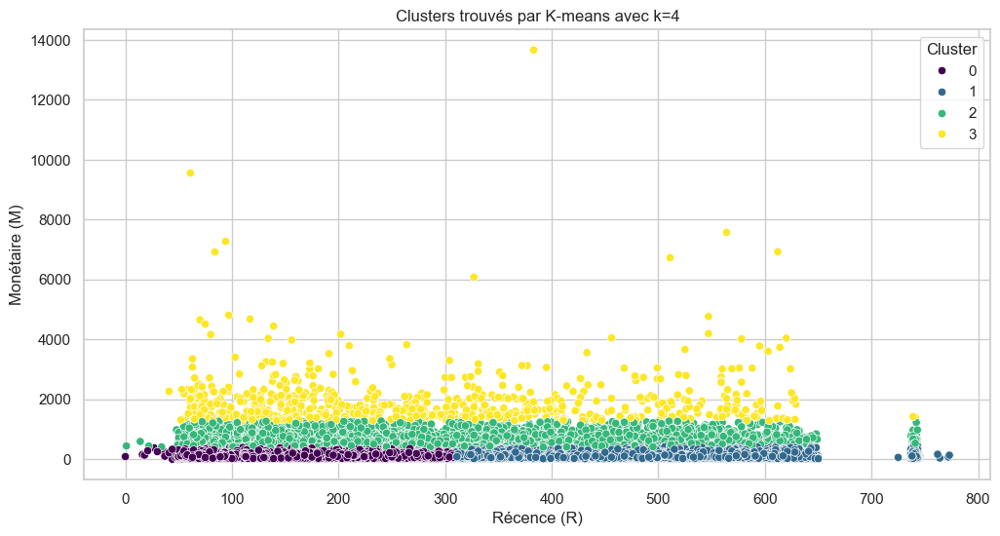

In [15]:
# Perform KMeans clustering with k=4
k = 4
features = ['recency', 'frequency', 'monetary', 'avg_review_score']
clustering_features = customer_data[features]

kmeans = KMeans(n_clusters=k, random_state=42)
kmeans.fit(clustering_features)

# Add the cluster labels to the RFM data
labels = kmeans.labels_
clustering_features['Cluster'] = labels

# Calculer le pourcentage d'individus dans chaque cluster
cluster_counts = pd.Series(labels).value_counts(normalize=True) * 100
cluster_percentages = cluster_counts.sort_index()
print(cluster_percentages)

# Create a 2D plot of clusters based on R and M
plt.figure(figsize=(12, 6))
sns.scatterplot(x='recency', y='monetary', hue='Cluster', data=clustering_features, palette='viridis')
plt.title('Clusters trouvés par K-means avec k=4')
plt.xlabel('Récence (R)')
plt.ylabel('Monétaire (M)')
plt.grid(True)
plt.show()

0    52.478793
1    39.188134
2     1.023159
3     7.309914
Name: proportion, dtype: float64


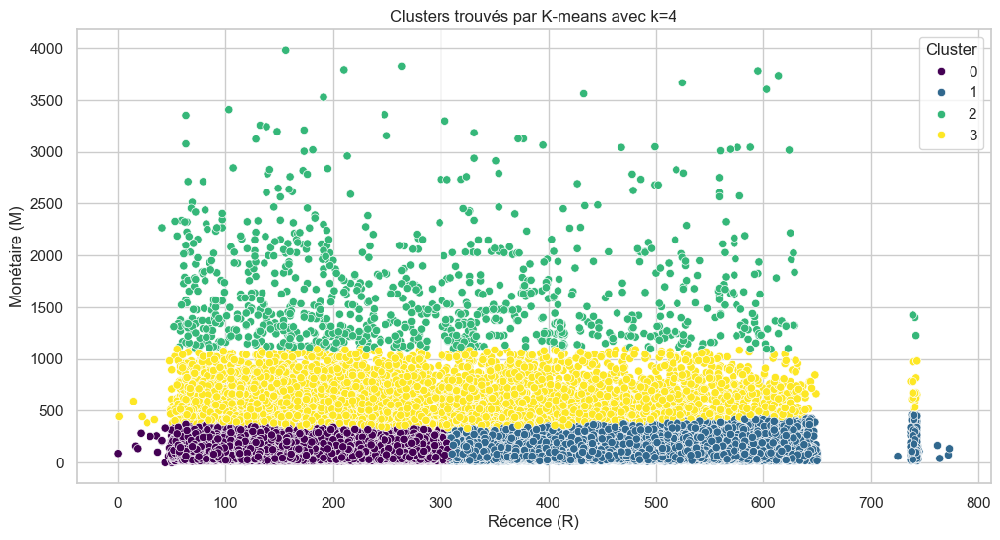

In [9]:
# Perform KMeans clustering with k=4
k = 4
features = ['recency', 'frequency', 'monetary', 'avg_review_score']
clustering_features = customer_data[features]
# Filtrer les données où monetary (M) est supérieur à 4000
clustering_features = clustering_features[clustering_features['monetary'] <= 4000]

kmeans = KMeans(n_clusters=k, random_state=42)
kmeans.fit(clustering_features)

# Add the cluster labels to the RFM data
labels = kmeans.labels_
clustering_features['Cluster'] = labels

# Calculer le pourcentage d'individus dans chaque cluster
cluster_counts = pd.Series(labels).value_counts(normalize=True) * 100
cluster_percentages = cluster_counts.sort_index()
print(cluster_percentages)

# Create a 2D plot of clusters based on R and M
plt.figure(figsize=(12, 6))
sns.scatterplot(x='recency', y='monetary', hue='Cluster', data=clustering_features, palette='viridis')
plt.title('Clusters trouvés par K-means avec k=4')
plt.xlabel('Récence (R)')
plt.ylabel('Monétaire (M)')
plt.grid(True)
plt.show()

/var/folders/17/7v9_fz593_xfss9zy0542f940000gn/T/ipykernel_22440/3847392702.py:13: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



0    53.246753
1    39.660340
2     6.344697
3     0.748210
Name: proportion, dtype: float64


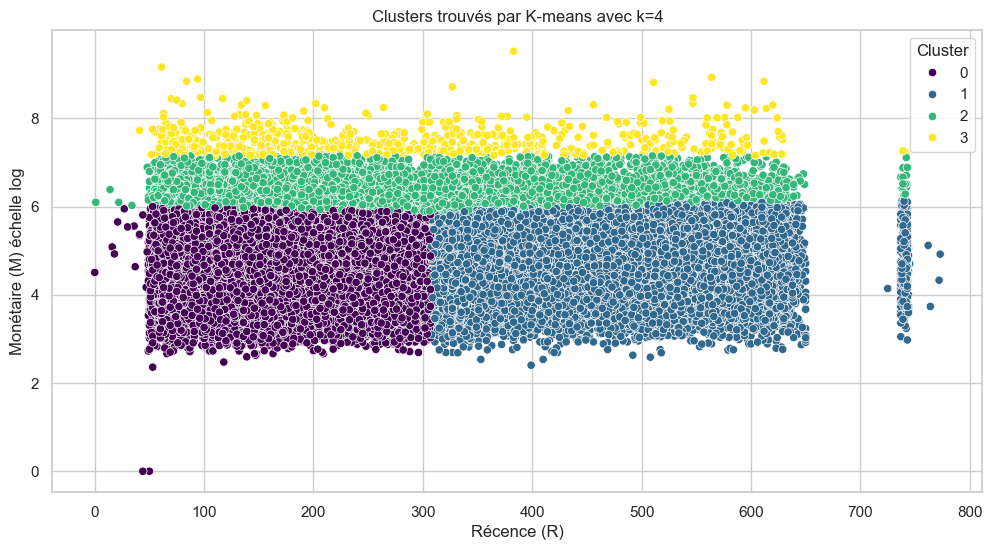

In [7]:
import numpy as np

# Perform KMeans clustering with k=4
k = 4
features = ['recency', 'frequency', 'monetary', 'avg_review_score']
clustering_features = customer_data[features]

kmeans = KMeans(n_clusters=k, random_state=42)
kmeans.fit(clustering_features)

# Add the cluster labels to the RFM data
labels = kmeans.labels_
clustering_features['Cluster'] = labels

# Calculer le pourcentage d'individus dans chaque cluster
cluster_counts = pd.Series(labels).value_counts(normalize=True) * 100
cluster_percentages = cluster_counts.sort_index()
print(cluster_percentages)

# Create a 2D plot of clusters based on R and M
plt.figure(figsize=(12, 6))
sns.scatterplot(x='recency', y=np.log1p(clustering_features['monetary']), hue='Cluster', data=clustering_features, palette='viridis')
plt.title('Clusters trouvés par K-means avec k=4')
plt.xlabel('Récence (R)')
plt.ylabel('Monétaire (M) échelle log')
plt.grid(True)
plt.show()

In [ ]:
import pandas as pd
from datetime import datetime
from sklearn.cluster import KMeans
from sklearn.manifold import TSNE
import plotly.express as px

# Select the necessary columns for clustering
features = ['recency', 'frequency', 'monetary', 'avg_review_score']
clustering_features = customer_data[features]

# Perform KMeans clustering with k=4
k_optimal = 4
kmeans_optimal = KMeans(n_clusters=k_optimal, random_state=42)
kmeans_optimal.fit(clustering_features)
customer_data['Cluster'] = kmeans_optimal.labels_

# Apply t-SNE for dimensionality reduction
tsne = TSNE(n_components=2, random_state=42)
rfm_features_tsne = tsne.fit_transform(clustering_features)

# Create the t-SNE plot
fig_tsne = px.scatter(
    x=rfm_features_tsne[:, 0], 
    y=rfm_features_tsne[:, 1], 
    color=customer_data['Cluster'].astype(str),
    title='t-SNE plot des clusters RFM avec k=4 et review score',
    labels={'color': 'Cluster'}
)

# Show the plot
fig_tsne.show()

/var/folders/17/7v9_fz593_xfss9zy0542f940000gn/T/ipykernel_72714/2887605028.py:31: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.



/var/folders/17/7v9_fz593_xfss9zy0542f940000gn/T/ipykernel_72714/2887605028.py:32: FutureWarning:

A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing

In [ ]:
import pandas as pd
from datetime import datetime
from sklearn.cluster import KMeans
from sklearn.manifold import TSNE
import plotly.express as px

# Select the necessary columns for clustering
features = ['recency', 'frequency', 'monetary', 'avg_review_score']
clustering_features = customer_data[features]

# Perform KMeans clustering with k=4
k_optimal = 3
kmeans_optimal = KMeans(n_clusters=k_optimal, random_state=42)
kmeans_optimal.fit(clustering_features)
customer_data['Cluster'] = kmeans_optimal.labels_

# Apply t-SNE for dimensionality reduction
tsne = TSNE(n_components=2, random_state=42)
rfm_features_tsne = tsne.fit_transform(clustering_features)

# Create the t-SNE plot
fig_tsne = px.scatter(
    x=rfm_features_tsne[:, 0], 
    y=rfm_features_tsne[:, 1], 
    color=customer_data['Cluster'].astype(str),
    title='t-SNE plot des clusters RFM avec k=3 et review score',
    labels={'color': 'Cluster'}
)

# Show the plot
fig_tsne.show()

/Users/anthonydavid/miniconda3/envs/OC-env-2/lib/python3.10/site-packages/plotly/express/_core.py:2065: FutureWarning:

When grouping with a length-1 list-like, you will need to pass a length-1 tuple to get_group in a future version of pandas. Pass `(name,)` instead of `name` to silence this warning.

